In [ ]:
# magics allow source file to be reloaded whenever changes are saved to disk
%load_ext autoreload
%autoreload 2

# Sargassum Detector


## Introduction


Sargassum is a seaweeed. Pelagic sargassum grows out in the open ocean and does not set roots on the ocean floor. In large quantities it causes many problems for tourism by polluting waters and beaches. The gas in the pods is toxic and foul smelling to humans, although some aqualife is supported by it. There are two types of pelagic sargassum, S. natans and S. fluitans:

![](sargassum_weeds_closeup.jpg)

The purpose of this project is to detect sargassum mats (large collections of sargassum) from image data - Landsat
Data Continuity Mission (LANDSAT) satellites images in the Galveston/Caribbean and bolivar peninsula region. Although there exists a methodology for detection (FAI - using power and ratio function compositions of pixel RGB channel data - [Hu et al. 2009](https://www.researchgate.net/profile/Muhammad_Bilal_phd/post/Can_anyone_tell_me_the_order_in_which_Floating_algal_Index_algorithm_for_MODIS_image_needs_to_be_implemented/attachment/59d63a0dc49f478072ea663e/AS:273724056506368@1442272308736/download/FAI.pdf)) and there has been some work on pixel classification using deep learning [Arellano-Verdejo 2019](https://peerj.com/articles/6842/) using the FAI index labels, it seems like an interesting problem for the newer methods in this application domain.

In particular, since I've been reading about object detection using focal loss on RetinaNet, we'll do that. It also helps that there is an implementation from a company, [Fizyr](https://fizyr.com/) in Germany and a guide with code on [freecodecamp](https://www.freecodecamp.org/news/object-detection-in-colab-with-fizyr-retinanet-efed36ac4af3/). Google's free [CoLab](https://colab.research.google.com) cloud AI computing platform will be used to train and predict on the model.

Potentially, this could be built into a useful WebApp to help tourists and the tourism industry/governments to manage resources and demand.


## Data

The ConvNet feature extractor will be taken from a pre-trained network,  ResNet50.  The labeled data will be created from raw LANDSAT data using a software and the markings on the images. 

This is all that is needed for the model to train and make predictions.

## Images

Some information on the image data:

- 700×6000 pixel data (RGB channel)
- 34 images from different sites
- 3 sites produces no images 
- Some have cloud cover
- Some images have land mass
- Some images have only sea/ocean
- Some have no sargassum labeled
- The sargassum foreground object is sparse in the image
- The satellite data are inside a window including comments and text 
- Needs to be cropped to get just the necessary data

## Raw Data

Image data is taken from [SEAS](http://seas-forecast.com/#work) platform. These are images of the annotated satellite images and text output. Here is an example:

![](./assets/images/Tuluma.jpg)

This data is provided for 37 sites in the Gulf of Mexico/Caribbean/Bolivar Peninsula, although the server didn't load 3 images - so we have 34 images left. This data is updated for sites at different dates and times.


## Preprocessing Data


### Crop Images

First we'll need to crop just the satellite images out of each image. For example:

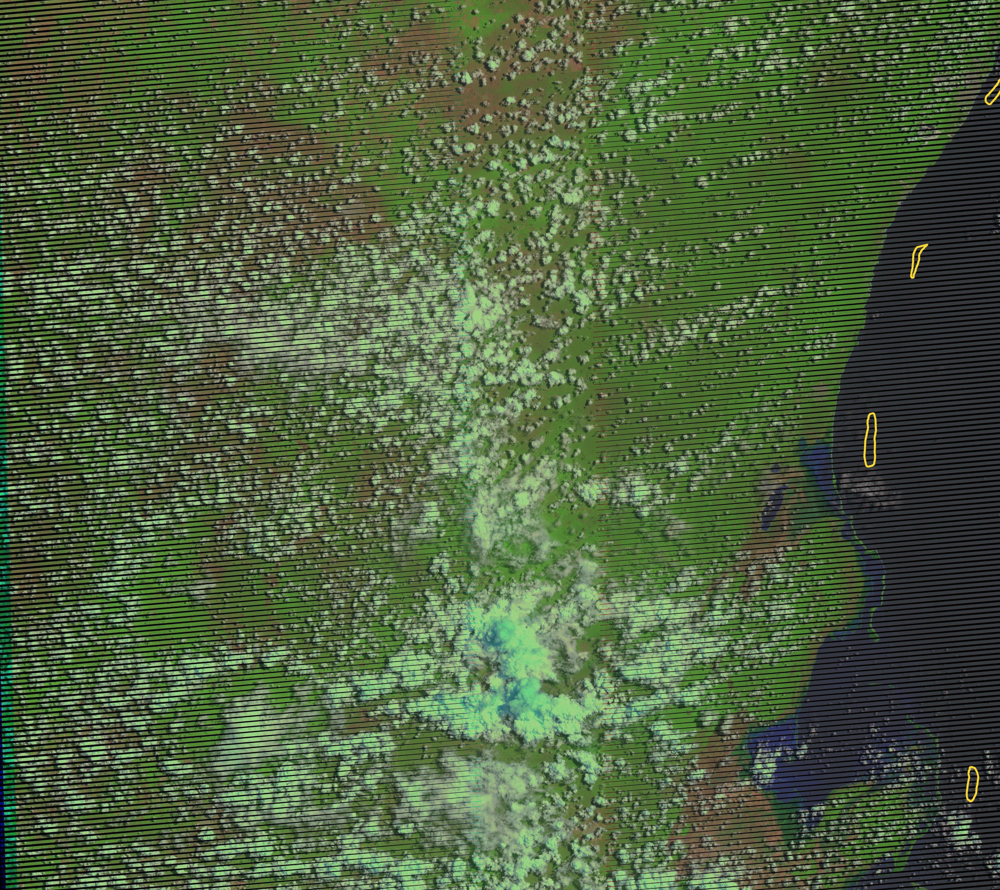

~~This may cause issues with the size of images for the detector, but we will visit that shortly - we can try having images being the size of the smallest crop or else padding the data.~~

In fact there's a discussion on this topic, which suggests that input data size [doesn't matter](https://github.com/fizyr/keras-retinanet/issues/519), so that's one less thing to worry about. 

### Data Augmentation

Then we may want to augment the data with rotations, crops, flips and random noise - this should be after the first training model harness is working. This is since there is little data.

### Labeling Data

This open source tool is used to create the bounding box ground truth labels in xml file format (with the same filename as the image file). Here is the tool for the Tulum image data.
 
![Image Labeling Tool](./assets/images/labelImg.png)

Once done for all images, this needs to be zipped, uploaded to google drive and convert the file format. This xml format needs to be converted to csv for the fizyer project. 

###  Linking Data to Training Algorithm

The uploaded files need a link to google drive. Since it's a small file format, all that is needed is to get the id - no dealing with specialized data handling software such as spark,


## Training

To train the classifier, we're going to take the code from a company, [fizyr](https://fizyr.com/) that built the retinanet of  the [focal loss paper](https://arxiv.org/pdf/1708.02002.pdf) using keras and a tutorial from [freecodecamp](https://www.freecodecamp.org/news/object-detection-in-colab-with-fizyr-retinanet-efed36ac4af3/) that tries to recognize goats from a backbone resnet.

We'll modify the tutorial code to learn from our images. It works, but is a little untidy:

* the section on uploading data is involved. It's easier to just use the python objects `drive` and `files` from the module `google.colab` to move data from storage to the runtime.

* converting the xml labeling data to csv could be made cleaner. We'll leave it as it is for now, since it works.

* There are comments for other options, these could be replaced with flags inside functions. 

* A lot of the code could be factored out into a script or, better yet module.

* Some of the naming conventions are loud and not clear.

We'll make some changes to improve how it reads.

About the training itself:

* The learning rate was $1e^{-5}$ and progress was markedly slow. I lowered this to $1e^{-2}$ but the parameters seemed to be diverging. So I increased it by a factor of 10 to $1e^{-3}$ and the cost function is declining better. This seems like a reasonable compromise.

* ~~The input images are given at a high resolution. We could try and reduce the image resolution of the input data~~. Actually, I've looked and the images were not cropped, but rather cut the first time using Preview. This means I need to actually crop (Tools > Crop) on selections and then produce label data again.

* The training feels slow, but I don't have benchmarks to compare to.

* The training has failed a few times on google colab, when the runtime was recycled. I might need to go in and change the training script to save the model after each epoch. Although, I did see training loss with 0.9, 0.85 for regression loss and 0.05 for classification loss. I believe these might be MSE on pixel error and percentage accuracy respectively, which should be good enough.

* I should ideally use tensorboard to see the training results from log files, once I know how to use it from colab.

* I need some more practice with tensorflow and neural networks.

* I could definitely try and understand better how the GPUs move data and their memory capacity- I've had a few warnings about memory on them.


## Inference

The model trained and the overall loss was around 0.64 (0.60 for regression, and 0.04 for classification - if we square root and assuming this is mostly the loss is due to regression, this fits are out by around 0.8 pixels). Here is a prediction of sargassum on an unseen image for Tulum:

![Tuluma Inference](./assets/images/tuluma_inference.png)

This is pretty good forecast, all the sargassum mat marks are being picked out. Here's one for Haiti - this image is clearer - it seems like it's not a camera/screenshot.

![Haiti East Inference](./assets/images/haiti_east_inference.png)

Also decent, the big sargassum mats were seen, two smaller ones were missed - one of them on the edge.

However, it's hard to generalize from one or two example. We need to evaluate a test set, get the average loss to see the results that we might expect on future examples.


## Conclusions

* It's not great that the marks on the screenshots are there. The detector might just be picking out yellow markings. Ideally we would want the original screenshots and labeled data completely separately.

* I was hoping for some forecasts on cloudy images - but there were none.

* Climate will impact how well a detector works.

* Still waiting on the research team that created this output to respond with more and potentially better data.

* There seems to be an algae index - FAI - a ratio of powers of RBG channels per pixel. There isn't conclusive information on how well it works to detect sargassum. I wonder if this could be used with a pixel specific algorithm - such as Mask RCNN to produce SOTA results.

